In [1]:
!pip install python-geohash

Processing /home/jovyan/.cache/pip/wheels/6f/be/45/5e0a0ce5bf42f2081c5b2906d4f1f146f825ec00c3759d1bd3/python_geohash-0.8.5-cp36-cp36m-linux_x86_64.whl


In [2]:
import rasterio
from shapely.geometry import Polygon, shape, mapping
from shapely.ops import unary_union
import geopandas as gp
import fiona
from fiona.crs import from_epsg
import xarray as xr
import pandas as pd
import glob
import os.path
import math
import geohash as gh
import re
import numpy as np

In [3]:
pwd

'/home/jovyan/dev/dea-notebooks/Gabrielle_dev/LCCS_wet_veg'

In [4]:
# Open into an xarray.DataArray
tcw_ds = xr.open_dataset('ls_tcw_percentiles/LS_TCW_PC_11_-40_19870101_20181025.nc')
tcw_ds

<xarray.Dataset>
Dimensions:    (time: 1, x: 4000, y: 4000)
Coordinates:
  * time       (time) datetime64[ns] 1987-01-01
  * y          (y) float64 -3.9e+06 -3.9e+06 -3.9e+06 ... -4e+06 -4e+06 -4e+06
  * x          (x) float64 1.1e+06 1.1e+06 1.1e+06 ... 1.2e+06 1.2e+06 1.2e+06
Data variables:
    crs        int32 ...
    TCW_PC_10  (time, y, x) float32 ...
    TCW_PC_50  (time, y, x) float32 ...
    TCW_PC_90  (time, y, x) float32 ...
    dataset    (time) |S17435612 ...
Attributes:
    date_created:           2018-11-29T10:22:22.381281
    Conventions:            CF-1.6, ACDD-1.3
    history:                NetCDF-CF file created by datacube version '1.6.1...
    geospatial_bounds:      POLYGON ((144.128374150833 -35.2304209533476,144....
    geospatial_bounds_crs:  EPSG:4326
    geospatial_lat_min:     -36.1267770885557
    geospatial_lat_max:     -35.141340045739746
    geospatial_lat_units:   degrees_north
    geospatial_lon_min:     144.12837415083308
    geospatial_lon_max:     145.33805252515648
    geospatial_lon_units:   degrees_east
    cmi_id:                 TCW_PERCENTILES_25_2.0.0
    title:                  Tasseled Cap Wetness Percentiles 25m 2.0.0
    description:            Tasseled Cap Wetness Percentile 25 metre, 100km t...
    summary:                The tasseled cap index percentiles provide statis...
    institution:            Commonwealth of Australia (Geoscience Australia)
    keywords_vocabulary:    GCMD
    keywords:               AU/GA,NASA/GSFC/SED/ESD/LANDSAT,REFLECTANCE,ETM+,...
    platform:               LANDSAT-5,LANDSAT-7,LANDSAT-8
    instrument:             TM,ETM+,OLI
    publisher_email:        earth.observation@ga.gov.au
    publisher_name:         Section Leader, Operations Section, NEMO, Geoscie...
    publisher_url:          http://www.ga.gov.au
    license:                CC BY Attribution 4.0 International License
    cdm_data_type:          Grid
    product_version:        2.0.0
    product_suite:          Tasseled Cap Index Stats 25m
    source:                 percentiles of tasseled cap wetness index v2.0.0
    acknowledgment:         - Landsat data is provided by the United States G...
    references:             - Crist, E.P., 1985. A TM tasseled cap equivalent...
    coverage_content_type:  modelResult

In [5]:
# Open into an xarray.DataArray
wofs_ds = xr.open_dataset('ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc')
wofs_ds

<xarray.Dataset>
Dimensions:      (time: 1, x: 4000, y: 4000)
Coordinates:
  * time         (time) datetime64[ns] 1970-01-01
  * y            (y) float64 -3.7e+06 -3.7e+06 -3.7e+06 ... -3.8e+06 -3.8e+06
  * x            (x) float64 8e+05 8e+05 8.001e+05 ... 8.999e+05 9e+05 9e+05
Data variables:
    crs          int32 ...
    count_wet    (time, y, x) float32 ...
    count_clear  (time, y, x) float32 ...
    frequency    (time, y, x) float32 ...
    dataset      (time) |S8896640 ...
Attributes:
    date_created:           2018-05-26T10:39:22.159360
    Conventions:            CF-1.6, ACDD-1.3
    history:                NetCDF-CF file created by datacube version '1.6rc...
    geospatial_bounds:      POLYGON ((140.683270860784 -33.6598720289938,140....
    geospatial_bounds_crs:  EPSG:4326
    geospatial_lat_min:     -34.55484547639721
    geospatial_lat_max:     -33.59522287145777
    geospatial_lat_units:   degrees_north
    geospatial_lon_min:     140.68327086078358
    geospatial_lon_max:     141.84816204491463
    geospatial_lon_units:   degrees_east
    cmi_id:                 WO-STATS_25_2.1.5
    title:                  Water Observations from Space Statistics 2.1.5
    summary:                WOfS-STATS (WO_STATS_2.1.5) is a set of statistic...
    institution:            Commonwealth of Australia (Geoscience Australia)
    keywords:               AU/GA,NASA/GSFC/SED/ESD/LANDSAT,ETM+,TM,OLI,EARTH...
    keywords_vocabulary:    GCMD
    product_version:        2.1.5
    publisher_email:        earth.observation@ga.gov.au
    publisher_name:         Section Leader, Operations Section, NEMO, Geoscie...
    publisher_url:          http://www.ga.gov.au
    license:                CC BY Attribution 4.0 International License
    cdm_data_type:          Grid
    product_suite:          Water Observations from Space Statistics 25m
    references:             N. Mueller, A. Lewis, D. Roberts, S. Ring, R. Mel...
    source:                 Water Observation from Space Detection Algorithm ...

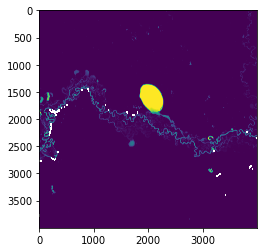

In [6]:
import matplotlib.pyplot as plt
plt.imshow(wofs_ds.frequency.isel(time=0))#.plot()

### 1.2 Set up the functions for this script

In [7]:
def Generate_list_of_albers_tiles(TileFolder="TileFolder", CustomData=True):
    """
    Generate a list of Albers tiles to loop through for the water body analysis. This 
    function assumes that the list of tiles will be generated from a custom 
    datacube-stats run, and the file names will have the format
    
    */wofs_summary_8_-37_{date}.nc
    
    The tile number is expected in the 2nd and 3rd last positions when the string has been
    broken using `_`. If this is not the case, then this code will not work, and will throw an error. 
    
    Parameters
    ----------
    
    TileFolder : str
        This is the path to the folder of netCDF files for analysis. If this is not provided, or an
        incorrect path name is provided, the code will exit with an error.
    CustomData : boolean
        This is passed in from elsewhere in the notebook. If this is not entered, the default parameter is True.
    
    Returns
    -------
    CustomRegionAlbersTiles: list
        List of Albers tiles across the analysis region. 
        E.g. ['8_-32', '9_-32', '10_-32', '8_-33', '9_-33']
    
    """
    if os.path.exists(TileFolder) == False:
        print(
            "** ERROR ** \n"
            "You need to specify a folder of files for running a custom region")
        return

    # Grab a list of all of the netCDF files in the tile folder
    TileFiles = glob.glob(f"{TileFolder}*.nc")

    CustomRegionAlbersTiles = set()
    for filePath in TileFiles:
        AlbersTiles = re.split("[_\.]", filePath)
        if CustomData:
            # Test that the albers tile numbers are actually where we expect them to be in the file name
            try:
                int(AlbersTiles[-4])
                int(AlbersTiles[-3])
            except ValueError:
                print(
                    "** ERROR ** \n"
                    'The netCDF files are expected to have the file format "*/wofs_summary_8_-37_{date}.nc",\n'
                    "with the Albers tile numbers in the 2nd and 3rd last positions when separated on `_`. \n"
                    "Please fix the file names, or alter the `Generate_list_of_albers_tiles` function."
                )
                return

            # Now that we're happy that the file is reading the correct Albers tiles
            ThisTile = f"{AlbersTiles[-3]}_{AlbersTiles[-2]}"
        else:
            # Test that the albers tile numbers are actually where we expect them to be in the file name
            try:
                int(AlbersTiles[-3])
                int(AlbersTiles[-2])
            except ValueError:
                print(
                    "** ERROR ** \n"
                    'The netCDF files are expected to have the file format "*/wofs_filtered_summary_8_-37.nc",\n'
                    "with the Albers tile numbers in the 2nd and 3rd last positions when separated on `_` and `.`. \n"
                    "Please fix the file names, or alter the `Generate_list_of_albers_tiles` function."
                )
                return

            # Now that we're happy that the file is reading the correct Albers tiles
            ThisTile = f"{AlbersTiles[-3]}_{AlbersTiles[-2]}"
        CustomRegionAlbersTiles.add(ThisTile)
    CustomRegionAlbersTiles = list(CustomRegionAlbersTiles)
    return CustomRegionAlbersTiles


def Generate_list_of_tile_datasets(ListofAlbersTiles,
                                   Year,
                                   TileFolder="TileFolder",
                                   CustomData=True):
    """
    Generate a list of Albers tiles datasets to loop through for the water body analysis. Here, the 
    ListofAlbersTiles is used to generate a list of NetCDF files where the Albers coordinates have 
    been substituted into the naming file format.
    
    Parameters
    ----------
    
    CustomRegionAlbersTiles: list
        List of albers tiles to loop through
        E.g. ['8_-32', '9_-32', '10_-32', '8_-33', '9_-33']
    Year: int
        Year for the analysis. This will correspond to the netCDF files for analysis.
    TileFolder : str
        This is the path to the folder of netCDF files for analysis. If this is not provided, or an
        incorrect path name is provided, the code will exit with an error.
    CustomData : boolean
        This is passed from elsewhere in the notebook. If this parameter is not entered, the default value
        is True.
    
    Returns
    -------
    Alltilespaths: list
        List of file paths to files to be analysed.
    
    """

    if os.path.exists(TileFolder) == False:
        print(
            "** ERROR ** \n"
            "You need to specify a folder of files for running a custom region")
        raise

    Alltilespaths = []

    if CustomData:
        for tile in ListofAlbersTiles:
            Tiles = glob.glob(f"{TileFolder}*_{tile}_{Year}0101.nc")
            Alltilespaths.append(
                Tiles[0])  # Assumes only one file will be returned
    else:
        for tile in ListofAlbersTiles:
            # Use glob to check that the file actually exists in the format we expect
            Tiles = glob.glob(f"{TileFolder}wofs_filtered_summary_{tile}.nc")
            # Check that assumption by seeing if the returned list is empty
            if not Tiles:
                Tiles = glob.glob(f"{TileFolder}WOFS_3577_{tile}_summary.nc")
            # Check that we actually have something now
            if not Tiles:
                print(
                    "** ERROR ** \n"
                    "An assumption in the file naming conventions has gone wrong somewhere.\n"
                    "We assume two file naming formats here: {TileFolder}wofs_filtered_summary_{tile}.nc, \n"
                    "and {TileFolder}WOFS_3577_{tile}_summary.nc. The files you have directed to don't meet \n"
                    "either assumption. Please fix the file names, or alter the `Generate_list_of_albers_tiles` function."
                )
            Alltilespaths.append(
                Tiles[0])  # Assumes only one file will be returned

    return Alltilespaths


def Filter_shapefile_by_intersection(gpdData,
                                     gpdFilter,
                                     filtertype="intersects",
                                     invertMask=True,
                                     returnInverse=False):
    """
    Filter out polygons that intersect with another polygon shapefile. 
    
    Parameters
    ----------
    
    gpdData: geopandas dataframe
        Polygon data that you wish to filter
    gpdFilter: geopandas dataframe
        Dataset you are using as a filter
    
    Optional
    --------
    filtertype: default = 'intersects'
        Options = ['intersects', 'contains', 'within']
    invertMask: boolean
        Default = 'True'. This determines whether you want areas that DO ( = 'False') or DON'T ( = 'True')
        intersect with the filter shapefile.
    returnInnverse: boolean
        Default = 'False'. If true, then return both parts of the intersection - those that intersect AND 
        those that don't as two dataframes.
    
    Returns
    -------
    gpdDataFiltered: geopandas dataframe
        Filtered polygon set, with polygons that intersect with gpdFilter removed.
    IntersectIndex: list of indices of gpdData that intersect with gpdFilter
    
    Optional
    --------
    if 'returnInverse = True'
    gpdDataFiltered, gpdDataInverse: two geopandas dataframes
        Filtered polygon set, with polygons that DON'T intersect with gpdFilter removed.
    """

    # Check that the coordinate reference systems of both dataframes are the same

    # assert gpdData.crs == gpdFilter.crs, 'Make sure the the coordinate reference systems of the two provided dataframes are the same'

    Intersections = gp.sjoin(gpdFilter, gpdData, how="inner", op=filtertype)

    # Find the index of all the polygons that intersect with the filter
    IntersectIndex = sorted(set(Intersections["index_right"]))

    # Grab only the polygons NOT in the IntersectIndex
    # i.e. that don't intersect with a river
    if invertMask:
        gpdDataFiltered = gpdData.loc[~gpdData.index.isin(IntersectIndex)]
    else:
        gpdDataFiltered = gpdData.loc[gpdData.index.isin(IntersectIndex)]

    if returnInverse:
        # We need to use the indices from IntersectIndex to find the inverse dataset, so we
        # will just swap the '~'.

        if invertMask:
            gpdDataInverse = gpdData.loc[gpdData.index.isin(IntersectIndex)]
        else:
            gpdDataInverse = gpdData.loc[~gpdData.index.isin(IntersectIndex)]

        return gpdDataFiltered, IntersectIndex, gpdDataInverse
    else:

        return gpdDataFiltered, IntersectIndex

In [8]:
AllOfAustraliaAllTime = False

CustomData = False
AutoGenerateTileList = False

In [9]:
# if CustomData:
#     # Path to the files you would like to use for the analysis
#     TileFolder = '/g/data/r78/cek156/datacube_stats/WOFSDamsAllTimeNSWMDB/'
# else:
#     # Default path to the WOfS summary product
#     TileFolder = '/g/data/fk4/datacube/002/TCI/ls_tcw_percentiles'

if CustomData:
    # Path to the files you would like to use for the analysis
    TileFolder = '/g/data/r78/cek156/datacube_stats/WOFSDamsAllTimeNSWMDB/'
else:
    # Default path to the WOfS summary product
    TileFolder = 'ls_tcw_percentiles/'

In [10]:
tile = '8_-38'
glob.glob(f"{TileFolder}WOFS_3577_{tile}_summary.nc")

['ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc']

In [11]:
TileFolder

'ls_tcw_percentiles/'

In [12]:
# We only want to generate the tile list if we are not doing all of Australia.
if not AllOfAustraliaAllTime:
    if AutoGenerateTileList:
        ListofAlbersTiles = Generate_list_of_albers_tiles(
            TileFolder, CustomData)
    else:
        # Provide you own list of tiles to be run
        ListofAlbersTiles = [
            '8_-38'
        ]

In [13]:
ListofAlbersTiles

['8_-38']

In [14]:
# ## Set up some file names for the inputs and outputs
# # The name and filepath of the intermediate output polygon set
# WaterBodiesShp = f'/g/data/r78/cek156/dea-notebooks/DEAWaterbodies/AusAllTime01-005HybridWaterbodies/Temp'

# # The name and filepath of the temp, filtered output polygon set
# WOFSshpMerged = f'/g/data/r78/cek156/dea-notebooks/DEAWaterbodies/AusAllTime01-005HybridWaterbodies/'
# WOFSshpFiltered = '/g/data/r78/cek156/dea-notebooks/DEAWaterbodies/AusAllTime01-005HybridWaterbodies/AusWaterBodiesFiltered.shp'

# # Final shapefile name
# FinalName = '/g/data/r78/cek156/dea-notebooks/DEAWaterbodies/AusAllTime01-005HybridWaterbodies/AusWaterBodies.shp'

## Set up some file names for the inputs and outputs
# The name and filepath of the intermediate output polygon set
WaterBodiesShp = f'/output/temp'

# The name and filepath of the temp, filtered output polygon set
WOFSshpMerged = f'/output/'
WOFSshpFiltered = '/output/AusWaterBodiesFiltered.shp'

# Final shapefile name
FinalName = '/output/AusWaterBodies.shp'

In [15]:
AtLeastThisWet = [0.05, 0.1]

### The process

In [16]:
# First, test whether the wetness threshold has been correctly set
if len(AtLeastThisWet) == 2:
    print(
        f'We will be running a hybrid wetness threshold. Please ensure that the major threshold is \n'
        f'listed second, with the supplementary threshold entered first.'
        f'**You have set {AtLeastThisWet[-1]} as the primary threshold,** \n'
        f'**with {AtLeastThisWet[0]} set as the supplementary threshold.**')
elif len(AtLeastThisWet) == 1:
    print(
        f'You have not set up the hybrid threshold option. If you meant to use this option, please \n'
        f'set this option by including two wetness thresholds in the `AtLeastThisWet` variable above. \n'
        f'The wetness threshold we will use is {AtLeastThisWet}.')
else:
    raise ValueError(
        f'There is something wrong with your entered wetness threshold. Please enter a list \n'
        f'of either one or two numbers. You have entered {AtLeastThisWet}. \n'
        f'See above for more information')

We will be running a hybrid wetness threshold. Please ensure that the major threshold is 
listed second, with the supplementary threshold entered first.**You have set 0.1 as the primary threshold,** 
**with 0.05 set as the supplementary threshold.**


In [17]:
# Now perform the analysis to generate the first iteration of polygons
for year in range(1980, 1981):

    ### Get the list of netcdf file names to loop through
    if AllOfAustraliaAllTime:
        # Grab everything from the published WOfS all time summaries
        Alltiles = glob.glob(f'{TileFolder}*.nc')
        print('1',Alltiles)
    else:
        Alltiles = Generate_list_of_tile_datasets(ListofAlbersTiles, year,
                                                  TileFolder, CustomData)
        print('2',Alltiles)

2 ['ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc']


In [18]:
        Alltiles = glob.glob(f'{TileFolder}*.nc')
        print('1',Alltiles)

1 ['ls_tcw_percentiles/LS_TCW_PC_11_-40_19870101_20181025.nc', 'ls_tcw_percentiles/WOFS_3577_11_-40_summary.nc', 'ls_tcw_percentiles/LS_TCW_PC_11_-40_19870101_20181025-Copy2.nc', 'ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc', 'ls_tcw_percentiles/WOFS_3577_14_-35_summary.nc']


In [19]:
# # Now perform the analysis to generate the first iteration of polygons
# for year in range(1980, 1981):

#     ### Get the list of netcdf file names to loop through
#     if AllOfAustraliaAllTime:
#         # Grab everything from the published WOfS all time summaries
#         Alltiles = glob.glob(f'{TileFolder}*.nc')
#     else:
#         Alltiles = Generate_list_of_tile_datasets(ListofAlbersTiles, year,
#                                                   TileFolder, CustomData)

#     for WOFSfile in Alltiles:
#         try:
#             # Read in the data
#             # Note that the netCDF files we are using here contain a variable called 'frequency',
#             # which is what we are using to define our water polygons.
#             # If you use a different netCDF input source, you may need to change this variable name here
#             WOFSnetCDFData = xr.open_rasterio(f'NETCDF:{WOFSfile}:frequency')
#             # Remove the superfluous time dimension
#             WOFSnetCDFData = WOFSnetCDFData.squeeze()

#             # Open the clear count variable to generate the minimum observation mask
#             # If you use a different netCDF input source, you may need to change this variable name here
#             WOFSvalidcount = xr.open_rasterio(f'NETCDF:{WOFSfile}:count_clear')
#             WOFSvalidcount = WOFSvalidcount.squeeze()

In [20]:
MinimumValidObs = 0

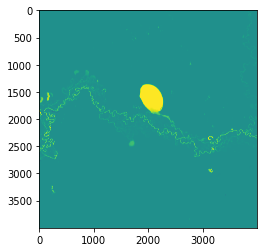

In [21]:
# Read in the data
# Note that the netCDF files we are using here contain a variable called 'frequency',
# which is what we are using to define our water polygons.
# If you use a different netCDF input source, you may need to change this variable name here
WOFSnetCDFData = xr.open_rasterio(f'NETCDF:ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc:frequency')
# Remove the superfluous time dimension
WOFSnetCDFData = WOFSnetCDFData.squeeze()
plt.imshow(WOFSnetCDFData)

# # Open the clear count variable to generate the minimum observation mask
# # If you use a different netCDF input source, you may need to change this variable name here
# WOFSvalidcount = xr.open_rasterio(f'NETCDF:ls_tcw_percentiles/WOFS_3577_8_-38_summary.nc:count_clear')
# WOFSvalidcount = WOFSvalidcount.squeeze()
# # plt.imshow(WOFSvalidcount)

# # Filter our WOfS classified data layer to remove noise
# # Remove any pixels not abserved at least MinimumValidObs times
# WOFSValidFiltered = WOFSvalidcount >= MinimumValidObs
# # plt.imshow(WOFSValidFiltered)

In [22]:
Thresholds = 0.1

In [23]:
import rasterio

In [24]:
import rasterio.features as ft

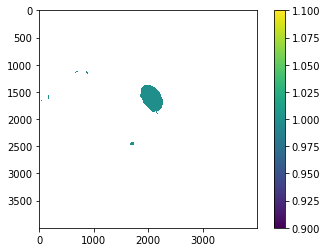

In [45]:
# Remove any pixels that are wet < AtLeastThisWet% of the time
WOFSfiltered = WOFSnetCDFData > Thresholds
# plt.imshow(WOFSfiltered)

# Now find pixels that meet both the MinimumValidObs and AtLeastThisWet criteria
# Change all zeros to NaN to create a nan/1 mask layer
# Pixels == 1 now represent our water bodies
WOFSfiltered = WOFSfiltered.where((WOFSfiltered == 1))
plt.imshow(WOFSfiltered)
plt.colorbar()


In [46]:
np.unique(WOFSfiltered)

array([ 1., nan, nan, ..., nan, nan, nan])

In [42]:
# Convert the raster to polygons
# We use a mask of '1' to only generate polygons around values of '1' (not NaNs)
WOFSpolygons = ft.shapes(
    WOFSfiltered.data.astype('float32'),
    mask=WOFSfiltered.data.astype('float32') == 1,
    transform=WOFSnetCDFData.transform)
# The rasterio.features.shapes returns a tuple. We only want to keep the geometry portion,
# not the value of each polygon (which here is just 1 for everything)
WOFSbreaktuple = (a for a, b in WOFSpolygons)
print('WOFSbreaktuple',WOFSbreaktuple)

# Put our polygons into a geopandas geodataframe
PolygonGP = gp.GeoDataFrame(list(WOFSbreaktuple))
# print('PolygonGP',PolygonGP)

# Grab the geometries and convert into a shapely geometry
# so we can quickly calcuate the area of each polygon
PolygonGP['geometry'] = None
for ix, poly in PolygonGP.iterrows():
    poly['geometry'] = shape(poly)

# Set the geometry of the dataframe to be the shapely geometry we just created
PolygonGP = PolygonGP.set_geometry('geometry')
# We need to add the crs back onto the dataframe
PolygonGP.crs = ('EPSG:3577')

print('PolygonGP',PolygonGP)

# # Combine any overlapping polygons
# MergedPolygonsGeoms = unary_union(PolygonGP['geometry'])
# print('MergedPolygonsGeoms',MergedPolygonsGeoms)

MergedPolygonsGPD = PolygonGP

# # Turn the combined multipolygon back into a geodataframe
# MergedPolygonsGPD = gp.GeoDataFrame(
#     [poly for poly in MergedPolygonsGeoms])
# # Rename the geometry column
# MergedPolygonsGPD.columns = ['geometry']
# # We need to add the crs back onto the dataframe
# MergedPolygonsGPD.crs = ('EPSG:3577')

# Calculate the area of each polygon again now that overlapping polygons
# have been merged
MergedPolygonsGPD['area'] = MergedPolygonsGPD['geometry'].area
print(MergedPolygonsGPD['area'])

WOFSbreaktuple <generator object <genexpr> at 0x7f76834b5830>
PolygonGP          type                                        coordinates geometry
0     Polygon  [[(860550.0, -3700000.0), (860550.0, -3700050....     None
1     Polygon  [[(861825.0, -3700000.0), (861825.0, -3700025....     None
2     Polygon  [[(861150.0, -3700000.0), (861150.0, -3700125....     None
3     Polygon  [[(859600.0, -3700075.0), (859600.0, -3700150....     None
4     Polygon  [[(897100.0, -3700100.0), (897100.0, -3700150....     None
...       ...                                                ...      ...
3340  Polygon  [[(806425.0, -3783950.0), (806425.0, -3784075....     None
3341  Polygon  [[(807150.0, -3784250.0), (807150.0, -3784275....     None
3342  Polygon  [[(806200.0, -3784100.0), (806200.0, -3784150....     None
3343  Polygon  [[(813600.0, -3792500.0), (813600.0, -3792525....     None
3344  Polygon  [[(868900.0, -3795775.0), (868900.0, -3795800....     None

[3345 rows x 3 columns]
0      NaN
1   

In [43]:
# Turn the combined multipolygon back into a geodataframe
PolygonGP['geometry'].area.max()

nan

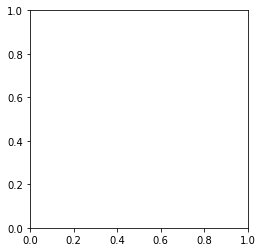

In [44]:
MergedPolygonsGPD.plot()

In [32]:
PolygonGP['geometry']

0       None
1       None
2       None
3       None
4       None
        ... 
3340    None
3341    None
3342    None
3343    None
3344    None
Name: geometry, Length: 3345, dtype: geometry

In [ ]:
### Whole thing

In [ ]:
# Now perform the analysis to generate the first iteration of polygons
for year in range(1980, 1981):

    ### Get the list of netcdf file names to loop through
    if AllOfAustraliaAllTime:
        # Grab everything from the published WOfS all time summaries
        Alltiles = glob.glob(f'{TileFolder}*.nc')
    else:
        Alltiles = Generate_list_of_tile_datasets(ListofAlbersTiles, year,
                                                  TileFolder, CustomData)

    for WOFSfile in Alltiles:
        try:
            # Read in the data
            # Note that the netCDF files we are using here contain a variable called 'frequency',
            # which is what we are using to define our water polygons.
            # If you use a different netCDF input source, you may need to change this variable name here
            WOFSnetCDFData = xr.open_rasterio(f'NETCDF:{WOFSfile}:frequency')
            # Remove the superfluous time dimension
            WOFSnetCDFData = WOFSnetCDFData.squeeze()

            # Open the clear count variable to generate the minimum observation mask
            # If you use a different netCDF input source, you may need to change this variable name here
            WOFSvalidcount = xr.open_rasterio(f'NETCDF:{WOFSfile}:count_clear')
            WOFSvalidcount = WOFSvalidcount.squeeze()

            # Filter our WOfS classified data layer to remove noise
            # Remove any pixels not abserved at least MinimumValidObs times
            WOFSValidFiltered = WOFSvalidcount >= MinimumValidObs

            for Thresholds in AtLeastThisWet:
                # Remove any pixels that are wet < AtLeastThisWet% of the time
                WOFSfiltered = WOFSnetCDFData > Thresholds

                # Now find pixels that meet both the MinimumValidObs and AtLeastThisWet criteria
                # Change all zeros to NaN to create a nan/1 mask layer
                # Pixels == 1 now represent our water bodies
                WOFSfiltered = WOFSfiltered.where((WOFSfiltered != 0) &
                                                  (WOFSValidFiltered != 0))

                # Convert the raster to polygons
                # We use a mask of '1' to only generate polygons around values of '1' (not NaNs)
                WOFSpolygons = ft.shapes(
                    WOFSfiltered.data.astype('float32'),
                    mask=WOFSfiltered.data.astype('float32') == 1,
                    transform=WOFSnetCDFData.transform)
                # The rasterio.features.shapes returns a tuple. We only want to keep the geometry portion,
                # not the value of each polygon (which here is just 1 for everything)
                WOFSbreaktuple = (a for a, b in WOFSpolygons)

                # Put our polygons into a geopandas geodataframe
                PolygonGP = gp.GeoDataFrame(list(WOFSbreaktuple))

                # Grab the geometries and convert into a shapely geometry
                # so we can quickly calcuate the area of each polygon
                PolygonGP['geometry'] = None
                for ix, poly in PolygonGP.iterrows():
                    poly['geometry'] = shape(poly)

                # Set the geometry of the dataframe to be the shapely geometry we just created
                PolygonGP = PolygonGP.set_geometry('geometry')
                # We need to add the crs back onto the dataframe
                PolygonGP.crs = {'init': 'epsg:3577'}

                # Combine any overlapping polygons
                MergedPolygonsGeoms = unary_union(PolygonGP['geometry'])

                # Turn the combined multipolygon back into a geodataframe
                MergedPolygonsGPD = gp.GeoDataFrame(
                    [poly for poly in MergedPolygonsGeoms])
                # Rename the geometry column
                MergedPolygonsGPD.columns = ['geometry']
                # We need to add the crs back onto the dataframe
                MergedPolygonsGPD.crs = {'init': 'epsg:3577'}

                # Calculate the area of each polygon again now that overlapping polygons
                # have been merged
                MergedPolygonsGPD['area'] = MergedPolygonsGPD['geometry'].area

                # Save the polygons to a shapefile
                schema = {
                    'geometry': 'Polygon',
                    'properties': {
                        'area': 'float'
                    }
                }

                # Generate our dynamic filename
                FileName = f'{WaterBodiesShp}_{Thresholds}.shp'
                # Append the file name to the list so we can call it later on

                if os.path.isfile(FileName):
                    with fiona.open(FileName,
                                    "a",
                                    crs=from_epsg(3577),
                                    driver='ESRI Shapefile',
                                    schema=schema) as output:
                        for ix, poly in MergedPolygonsGPD.iterrows():
                            output.write(({
                                'properties': {
                                    'area': poly['area']
                                },
                                'geometry': mapping(shape(poly['geometry']))
                            }))
                else:
                    with fiona.open(FileName,
                                    "w",
                                    crs=from_epsg(3577),
                                    driver='ESRI Shapefile',
                                    schema=schema) as output:
                        for ix, poly in MergedPolygonsGPD.iterrows():
                            output.write(({
                                'properties': {
                                    'area': poly['area']
                                },
                                'geometry': mapping(shape(poly['geometry']))
                            }))

        except:
            print(
                f'{WOFSfile} did not run. \n'
                f'This is probably because there are no waterbodies present in this tile.'
            )